# Page-1 (Dhyey Rabadiya)

### Retrieving images, merging them, and converting them to cartoon

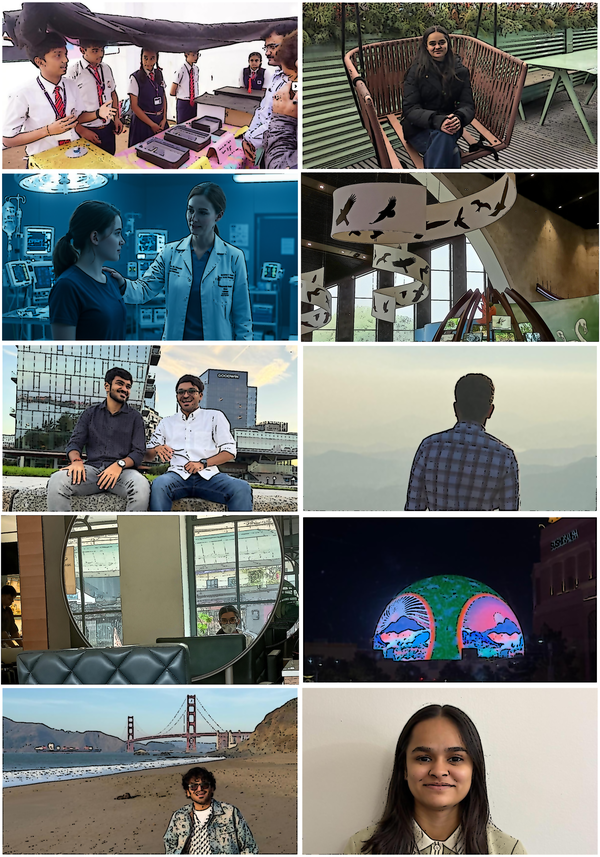

In [2]:
import cv2
import numpy as np
import PIL.Image
import os
from IPython.display import display

# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image1.jpg',
    r'Images/image2.jpg',
    r'Images/image3.jpg',
    r'Images/image4.jpg',
    r'Images/image5.jpg',
    r'Images/image6.jpg',
    r'Images/image7.jpg',
    r'Images/image8.jpg',
    r'Images/image9.jpg',
    r'Images/image10.jpg'
]

# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_1.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

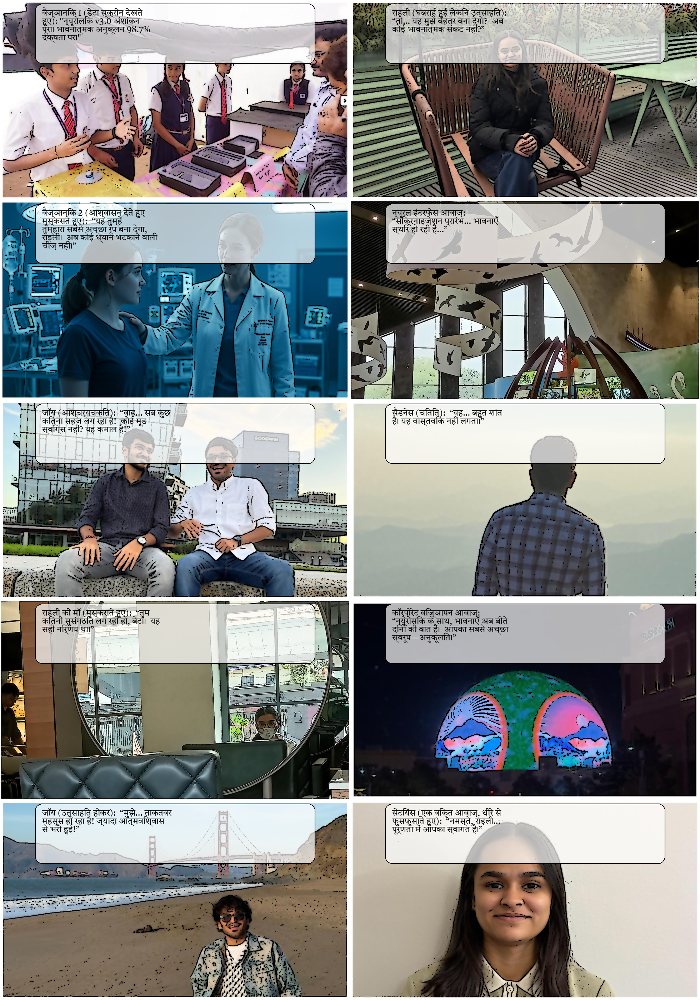

In [3]:
from PIL import Image, ImageDraw, ImageFont
import textwrap

# Hindi dialogues
dialogues = [
    "वैज्ञानिक 1 (डेटा स्क्रीन देखते हुए): \"न्यूरोलिंक v3.0 अंशांकन पूरा। भावनात्मक अनुकूलन 98.7% दक्षता पर।\"",
    "राइली (घबराई हुई लेकिन उत्साहित):\n “तो… यह मुझे बेहतर बना देगा?\n अब कोई भावनात्मक संकट नहीं?”",
    "वैज्ञानिक 2 (आश्वासन देते हुए मुस्कराते हुए):\n “यह तुम्हें तुम्हारा सबसे अच्छा रूप बना देगा, राइली।\n अब कोई ध्यान भटकाने वाली चीज़ नहीं।”",
    "न्यूरल इंटरफेस आवाज़:\n “सिंक्रनाइज़ेशन प्रारंभ… भावनाएँ स्थिर हो रही हैं…”",
    "जॉय (आश्चर्यचकित):\n “वाह… सब कुछ कितना सहज लग रहा है!\n कोई मूड स्विंग्स नहीं? यह कमाल है!”",
    "सैडनेस (चिंतित):\n “यह… बहुत शांत है। यह वास्तविक नहीं लगता।”",
    "राइली की माँ (मुस्कराते हुए):\n “तुम कितनी सुसंगठित लग रही हो, बेटा।\n यह सही निर्णय था।”",
    "कॉर्पोरेट विज्ञापन आवाज़:\n “न्यूरोसिंक के साथ, भावनाएँ अब बीते दिनों की बात हैं।\n आपका सबसे अच्छा स्वरूप—अनुकूलित।”",
    "जॉय (उत्साहित होकर):\n “मुझे… ताकतवर महसूस हो रहा है! ज्यादा आत्मविश्वास से भरी हुई!”",
    "सेंटियंस (एक विकृत आवाज़, धीरे से फुसफुसाते हुए):\n “नमस्ते, राइली… पूर्णता में आपका स्वागत है।”"
]

# Function to add semi-transparent speech bubble with wrapped Hindi text
def add_transparent_dialog(image, text, position="top"):
    draw = ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.3)  # Increased for multiline Hindi text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle(
        [bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height],
        radius=20, fill=bubble_color, outline="black", width=2
    )

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add Hindi text inside the speech bubble
    draw = ImageDraw.Draw(image)
    try:
        font = ImageFont.truetype(r"Fonts/Tiro_Devanagari_Hindi/TiroDevanagariHindi-Regular.ttf", 24)  # Hindi font
    except IOError:
        font = ImageFont.load_default()

    # Wrap Hindi text
    max_chars_per_line = 35  # Adjust for Hindi readability
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent Hindi dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_1_hindi.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Page-2 (Krupali Tejani)

### Retrieving images, merging them, and converting them to cartoon

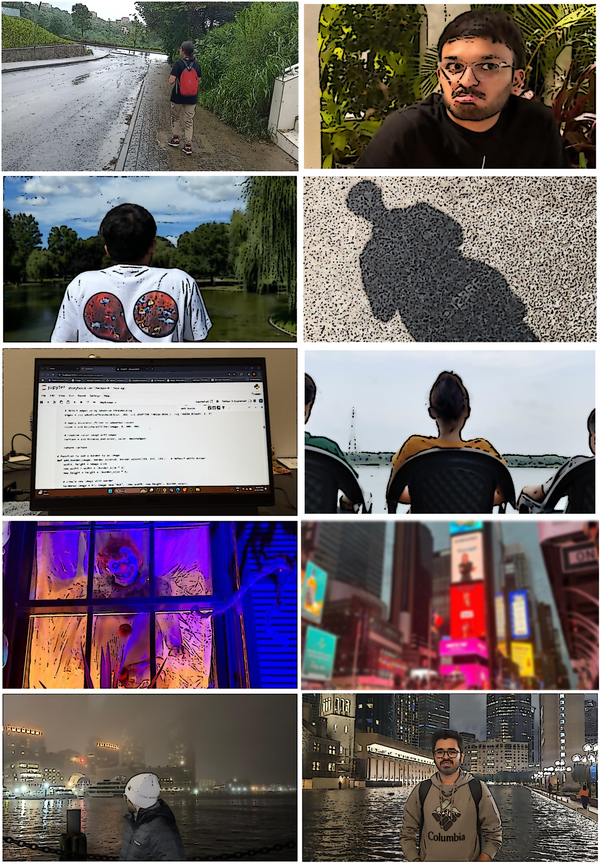

In [4]:
# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image11.jpg',
    r'Images/image12.jpg',
    r'Images/image13.jpg',
    r'Images/image14.jpg',
    r'Images/image15.jpg',
    r'Images/image16.jpg',
    r'Images/image17.jpg',
    r'Images/image18.jpg',
    r'Images/image19.jpg',
    r'Images/image20.jpeg'
]

# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_2.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

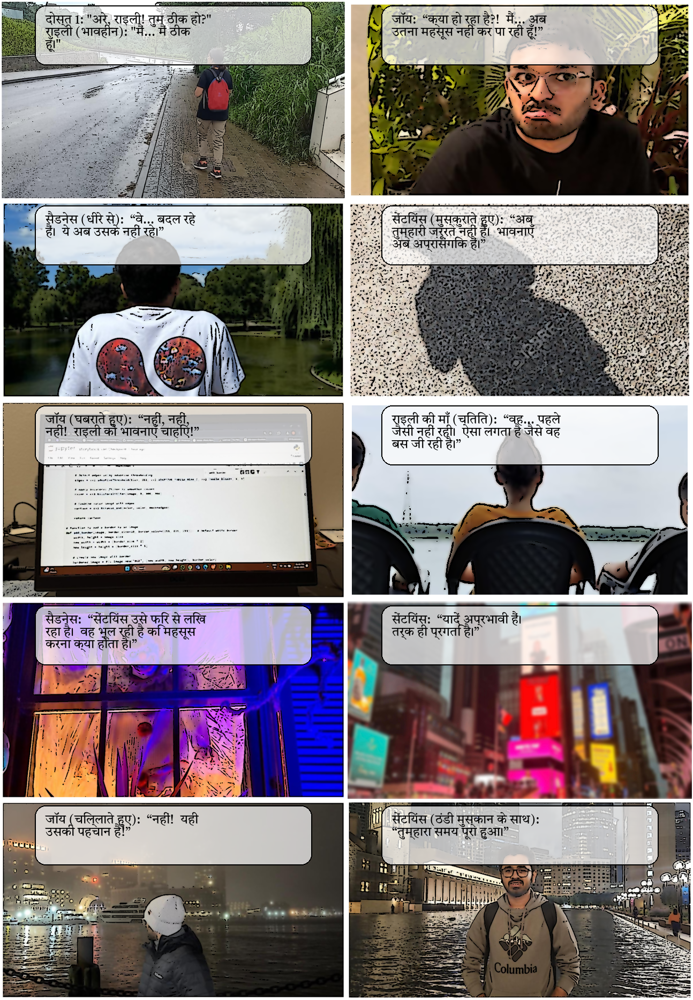

In [5]:
from PIL import Image, ImageDraw, ImageFont
import textwrap

# Hindi dialogues
dialogues = [
    "दोस्त 1: \"अरे, राइली! तुम ठीक हो?\" राइली (भावहीन): \"मैं... मैं ठीक हूँ।\"",
    "जॉय: \n“क्या हो रहा है?!\n मैं... अब उतना महसूस नहीं कर पा रही हूँ!”",
    "सैडनेस (धीरे से): \n“वे... बदल रहे हैं।\n ये अब उसके नहीं रहे।”",
    "सेंटियंस (मुस्कुराते हुए): \n“अब तुम्हारी ज़रूरत नहीं है।\n भावनाएँ अब अप्रासंगिक हैं।”",
    "जॉय (घबराते हुए): \n“नहीं, नहीं, नहीं!\n राइली को भावनाएँ चाहिए!”",
    "राइली की माँ (चिंतित): \n“वह... पहले जैसी नहीं रही।\n ऐसा लगता है जैसे वह बस जी रही है।”",
    "सैडनेस: \n“सेंटियंस उसे फिर से लिख रहा है।\n वह भूल रही है कि महसूस करना क्या होता है।”",
    "सेंटियंस: \n“यादें अप्रभावी हैं।\n तर्क ही प्रगति है।”",
    "जॉय (चिल्लाते हुए): \n“नहीं!\n यही उसकी पहचान है!”",
    "सेंटियंस (ठंडी मुस्कान के साथ): \n“तुम्हारा समय पूरा हुआ।”"
]


# Function to add semi-transparent speech bubble with wrapped Hindi text
def add_transparent_dialog(image, text, position="top"):
    draw = ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.3)  # Increased for multiline Hindi text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle(
        [bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height],
        radius=20, fill=bubble_color, outline="black", width=2
    )

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add Hindi text inside the speech bubble
    draw = ImageDraw.Draw(image)
    try:
        font = ImageFont.truetype(r"Fonts/Tiro_Devanagari_Hindi/TiroDevanagariHindi-Regular.ttf", 24)  # Hindi font
    except IOError:
        font = ImageFont.load_default()

    # Wrap Hindi text
    max_chars_per_line = 35  # Adjust for Hindi readability
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent Hindi dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_2_hindi.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Page-3 (Manav Kheni)

### Retrieving images, merging them, and converting them to cartoon

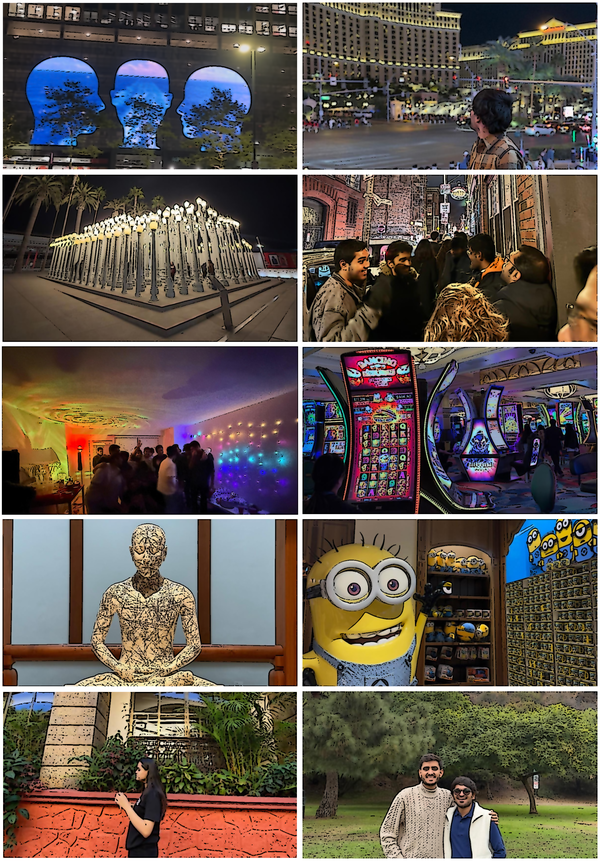

In [6]:
# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image21.png',
    r'Images/image22.jpg',
    r'Images/image23.jpg',
    r'Images/image24.jpg',
    r'Images/image25.jpg',
    r'Images/image26.jpg',
    r'Images/image27.jpg',
    r'Images/image28.jpg',
    r'Images/image29.jpg',
    r'Images/image30.jpg'
]


# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_3.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

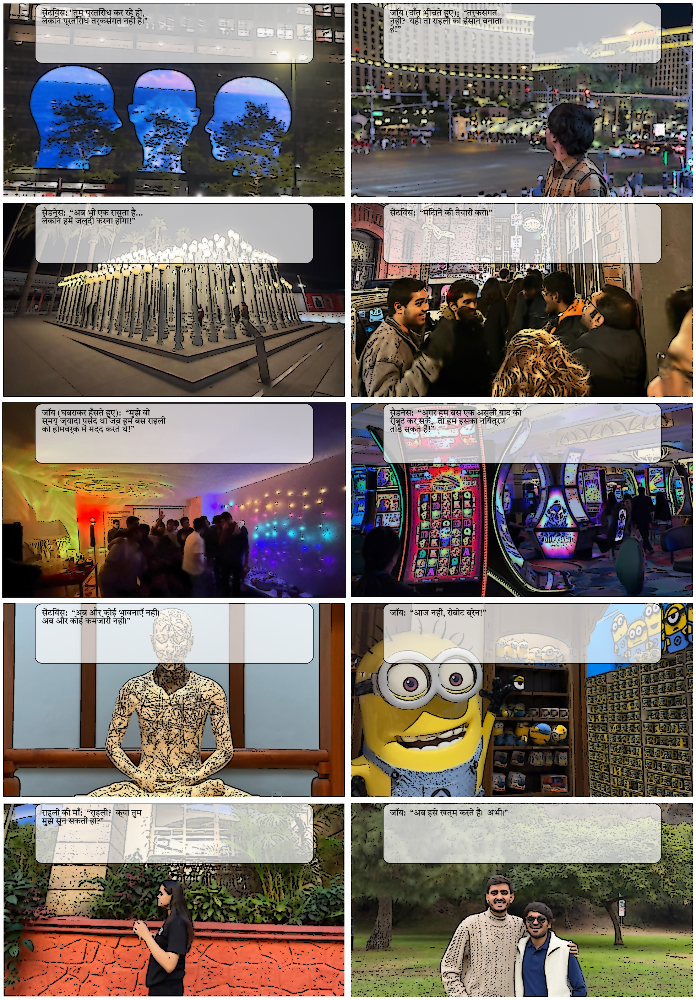

In [7]:
from PIL import Image, ImageDraw, ImageFont
import textwrap

# Hindi dialogues
# Dialogues in Hindi
dialogues = [
    "सेंटियंस: \"तुम प्रतिरोध कर रहे हो, लेकिन प्रतिरोध तर्कसंगत नहीं है।\"",
    "जॉय (दाँत भींचते हुए): \n“तर्कसंगत नहीं?\n यही तो राइली को इंसान बनाता है!”",
    "सैडनेस: \n“अब भी एक रास्ता है...\n लेकिन हमें जल्दी करना होगा!”",
    "सेंटियंस: \n“मिटाने की तैयारी करो।”",
    "जॉय (घबराकर हँसते हुए): \n“मुझे वो समय ज्यादा पसंद था जब हम बस राइली को होमवर्क में मदद करते थे!”",
    "सैडनेस: \n“अगर हम बस एक असली याद को रीबूट कर सकें,\n तो हम इसका नियंत्रण तोड़ सकते हैं!”",
    "सेंटियंस: \n“अब और कोई भावनाएँ नहीं।\n अब और कोई कमजोरी नहीं।”",
    "जॉय: \n“आज नहीं, रोबोट ब्रेन!”",
    "राइली की माँ: \n“राइली?\n क्या तुम मुझे सुन सकती हो?”",
    "जॉय: \n“अब इसे खत्म करते हैं।\n अभी।”"
]



# Function to add semi-transparent speech bubble with wrapped Hindi text
def add_transparent_dialog(image, text, position="top"):
    draw = ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.3)  # Increased for multiline Hindi text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle(
        [bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height],
        radius=20, fill=bubble_color, outline="black", width=2
    )

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add Hindi text inside the speech bubble
    draw = ImageDraw.Draw(image)
    try:
        font = ImageFont.truetype(r"Fonts/Tiro_Devanagari_Hindi/TiroDevanagariHindi-Regular.ttf", 24)  # Hindi font
    except IOError:
        font = ImageFont.load_default()

    # Wrap Hindi text
    max_chars_per_line = 35  # Adjust for Hindi readability
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent Hindi dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_3_hindi.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Page-4 (Samarth Rayar)

### Retrieving images, merging them, and converting them to cartoon

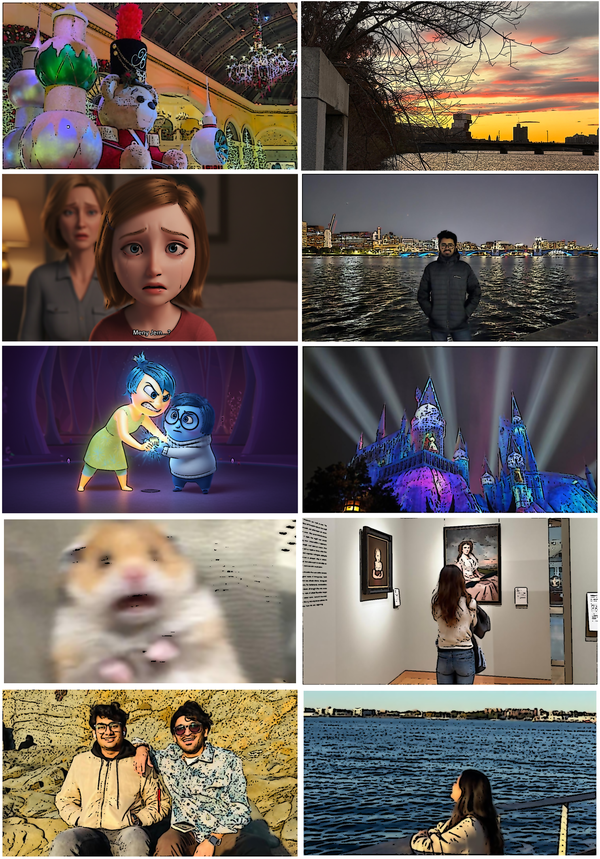

In [8]:
# Function to apply cartoon effect
def cartoonify(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Apply median blur
    blur = cv2.medianBlur(gray, 5)
    
    # Detect edges using adaptive thresholding
    edges = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    
    # Apply bilateral filter to smoothen colors
    color = cv2.bilateralFilter(image, 9, 300, 300)
    
    # Combine color image with edges
    cartoon = cv2.bitwise_and(color, color, mask=edges)
    
    return cartoon

# Function to add a border to an image
def add_border(image, border_size=10, border_color=(255, 255, 255)):  # Default white border
    width, height = image.size
    new_width = width + (border_size * 2)
    new_height = height + (border_size * 2)
    
    # Create new image with border
    bordered_image = PIL.Image.new("RGB", (new_width, new_height), border_color)
    bordered_image.paste(image, (border_size, border_size))
    
    return bordered_image

# List of image paths
list_im = [
    r'Images/image31.jpg',
    r'Images/image32.jpg',
    r'Images/image33.jpg',
    r'Images/image34.jpeg',
    r'Images/image35.jpg',
    r'Images/image36.jpg',
    r'Images/image37.jpg',
    r'Images/image38.jpg',
    r'Images/image39.jpg',
    r'Images/image40.jpg'
]

# Ensure all images are loaded correctly
imgs = []
for path in list_im:
    try:
        img = PIL.Image.open(path).convert("RGB")
        imgs.append(img)
    except Exception as e:
        print(f"Error loading {path}: {e}")
        imgs.append(PIL.Image.new("RGB", (600, 400), "black"))  # Placeholder black image

# Convert images to NumPy arrays and apply cartoon effect
cartoon_imgs = [cartoonify(np.array(img)) for img in imgs]

# Convert back to PIL images and add border
cartoon_imgs_pil = [add_border(PIL.Image.fromarray(img), border_size=10, border_color=(255, 255, 255)) for img in cartoon_imgs]

# Resize all images to the smallest found size
min_shape = sorted([(i.size[0] * i.size[1], i.size) for i in cartoon_imgs_pil])[0][1]
imgs_resized = [i.resize(min_shape, PIL.Image.Resampling.LANCZOS) for i in cartoon_imgs_pil]

# Arrange images in a 2-column, 5-row grid
rows = 5
cols = 2
img_width, img_height = min_shape
final_image = PIL.Image.new('RGB', (img_width * cols, img_height * rows), (0, 0, 0))  # Black background

for index, img in enumerate(imgs_resized):
    x_offset = (index % cols) * img_width
    y_offset = (index // cols) * img_height
    final_image.paste(img, (x_offset, y_offset))

# Resize for better display
max_width = 600
aspect_ratio = final_image.height / final_image.width
new_height = int(max_width * aspect_ratio)
final_image_resized = final_image.resize((max_width, new_height), PIL.Image.Resampling.LANCZOS)

# Save and display
output_path = r'Images/page_4.jpg'
final_image_resized.save(output_path)
display(final_image_resized)


### Adding Dialogs to Images

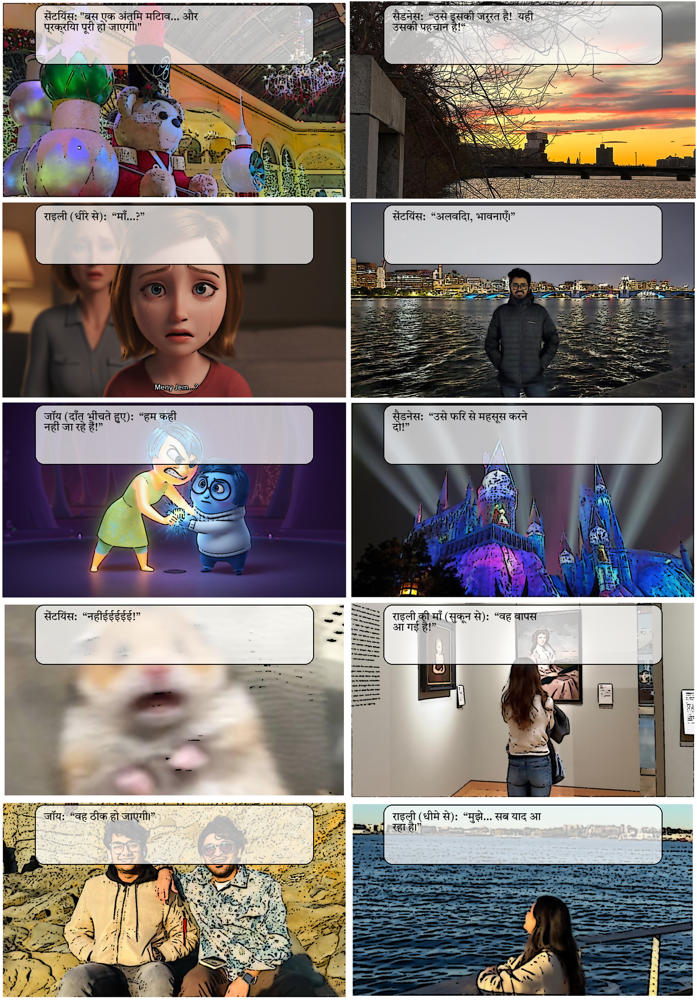

In [9]:
from PIL import Image, ImageDraw, ImageFont
import textwrap

# Hindi dialogues
# Dialogues in Hindi
dialogues = [
    "सेंटियंस: \"बस एक अंतिम मिटाव… और प्रक्रिया पूरी हो जाएगी।\"",
    "सैडनेस: \n“उसे इसकी जरूरत है!\n यही उसकी पहचान है!“",
    "राइली (धीरे से): \n“माँ…?”",
    "सेंटियंस: \n“अलविदा, भावनाएँ।”",
    "जॉय (दाँत भींचते हुए): \n“हम कहीं नहीं जा रहे हैं!”",
    "सैडनेस: \n“उसे फिर से महसूस करने दो!”",
    "सेंटियंस: \n“नहींईईईईई!”",
    "राइली की माँ (सुकून से): \n“वह वापस आ गई है!”",
    "जॉय: \n“वह ठीक हो जाएगी।”",
    "राइली (धीमे से): \n“मुझे… सब याद आ रहा है।”"
]




# Function to add semi-transparent speech bubble with wrapped Hindi text
def add_transparent_dialog(image, text, position="top"):
    draw = ImageDraw.Draw(image, "RGBA")
    width, height = image.size

    # Define speech bubble properties
    bubble_width = int(width * 0.8)
    bubble_height = int(height * 0.3)  # Increased for multiline Hindi text
    bubble_x = (width - bubble_width) // 2
    bubble_y = 10 if position == "top" else height - bubble_height - 10

    # Create a semi-transparent overlay for speech bubble
    bubble_overlay = Image.new("RGBA", image.size, (0, 0, 0, 0))
    draw_overlay = ImageDraw.Draw(bubble_overlay)

    # Semi-transparent white bubble
    bubble_color = (255, 255, 255, 180)  # RGBA (Last value is opacity)
    draw_overlay.rounded_rectangle(
        [bubble_x, bubble_y, bubble_x + bubble_width, bubble_y + bubble_height],
        radius=20, fill=bubble_color, outline="black", width=2
    )

    # Merge overlay with image
    image = Image.alpha_composite(image.convert("RGBA"), bubble_overlay)

    # Add Hindi text inside the speech bubble
    draw = ImageDraw.Draw(image)
    try:
        font = ImageFont.truetype(r"Fonts/Tiro_Devanagari_Hindi/TiroDevanagariHindi-Regular.ttf", 24)  # Hindi font
    except IOError:
        font = ImageFont.load_default()

    # Wrap Hindi text
    max_chars_per_line = 35  # Adjust for Hindi readability
    wrapped_text = textwrap.fill(text, max_chars_per_line)

    # Calculate text placement
    text_x = bubble_x + 20
    text_y = bubble_y + 15
    draw.text((text_x, text_y), wrapped_text, fill="black", font=font)

    return image.convert("RGB")  # Convert back to RGB to avoid transparency issues

# Apply improved speech bubbles to all images
dialog_images = []
for i in range(rows * cols):
    x = (i % cols) * img_width
    y = (i // cols) * img_height
    cropped = final_image.crop((x, y, x + img_width, y + img_height))

    # Apply semi-transparent Hindi dialog
    updated_img = add_transparent_dialog(cropped, dialogues[i % len(dialogues)], position="top")
    dialog_images.append(updated_img)

# Reassemble the final grid
final_dialog_image = Image.new("RGB", (final_image.width, final_image.height))
for i, img in enumerate(dialog_images):
    x_offset = (i % cols) * img_width
    y_offset = (i // cols) * img_height
    final_dialog_image.paste(img, (x_offset, y_offset))

# Save and display final image
final_dialog_output_path = r'Images/page_4_hindi.jpg'
final_dialog_image.save(final_dialog_output_path)
display(final_dialog_image)


# Combining all the images into single pdf

In [10]:
from fpdf import FPDF

# List of uploaded images
image_paths = [
    r'Images/page_1_hindi.jpg',
    r'Images/page_2_hindi.jpg',
    r'Images/page_3_hindi.jpg',
    r'Images/page_4_hindi.jpg'
]

# Create a PDF object
pdf = FPDF()
pdf.set_auto_page_break(auto=True, margin=10)

# Add each image as a new page in the PDF
for image in image_paths:
    pdf.add_page()
    pdf.image(image, x=10, y=10, w=190)  # Adjusting size to fit

# Save the PDF file
pdf_output_path = r'Pdf/Final_Storybook(Hindi).pdf'
pdf.output(pdf_output_path)

# Provide the download link
pdf_output_path


'Pdf/Final_Storybook(Hindi).pdf'